# Lecture : Graph-based Visualization

## Lab 05 : T-Distributed Stochastic Neighbor Embedding (TSNE)

### Xavier Bresson  


In [1]:
# For Google Colaboratory
import sys, os
if 'google.colab' in sys.modules:
    # mount google drive
    from google.colab import drive
    drive.mount('/content/gdrive')
    path_to_file = '/content/gdrive/My Drive/CS5284_2024_codes/codes/06_Visualization'
    print(path_to_file)
    # change current path to the folder containing "path_to_file"
    os.chdir(path_to_file)
    !pwd
    

In [2]:
# Load libraries
import numpy as np
import scipy.io
from matplotlib import pyplot
import matplotlib.pyplot as plt
import time
import sys; sys.path.insert(0, 'lib/')
import scipy.sparse.linalg
# import scipy.ndimage
from lib.utils import construct_knn_graph, nldr_visualization
import warnings; warnings.filterwarnings("ignore")
from sklearn.manifold import TSNE
import torch


# LapEigMap for MNIST

In [3]:
# MNIST dataset
mat = scipy.io.loadmat('datasets/MNIST_data.mat')
X = Xnumpy = mat['X']
n = X.shape[0]
d = X.shape[1]
C = mat['C'].squeeze()
print(n,d)

# extract a subset of data points
# idx_rand = torch.randperm(n)[:10000]; X = X[idx_rand,:]; C = C[idx_rand]; print(X.shape,C.shape)


60000 784


batch_size 510
Convert from numpy to pytorch
k-NN graph construction with euclidean distance
n, batch_size, num_batch, kNN, device: 60000 510 118 10 cpu
batch idx: 1 / 118  time(sec): 0.6440114974975586
batch idx: 2 / 118  time(sec): 1.220283031463623
batch idx: 3 / 118  time(sec): 1.7862184047698975
batch idx: 4 / 118  time(sec): 2.3529393672943115
batch idx: 5 / 118  time(sec): 2.9310145378112793
batch idx: 6 / 118  time(sec): 3.505977153778076
batch idx: 7 / 118  time(sec): 4.076769590377808
batch idx: 8 / 118  time(sec): 4.639204263687134
batch idx: 9 / 118  time(sec): 5.2134459018707275
batch idx: 10 / 118  time(sec): 5.782692909240723
batch idx: 11 / 118  time(sec): 6.365406513214111
batch idx: 12 / 118  time(sec): 6.933448076248169
batch idx: 13 / 118  time(sec): 7.493935585021973
batch idx: 14 / 118  time(sec): 8.05936574935913
batch idx: 15 / 118  time(sec): 8.637062788009644
batch idx: 16 / 118  time(sec): 9.20728611946106
batch idx: 17 / 118  time(sec): 9.768731832504272
bat

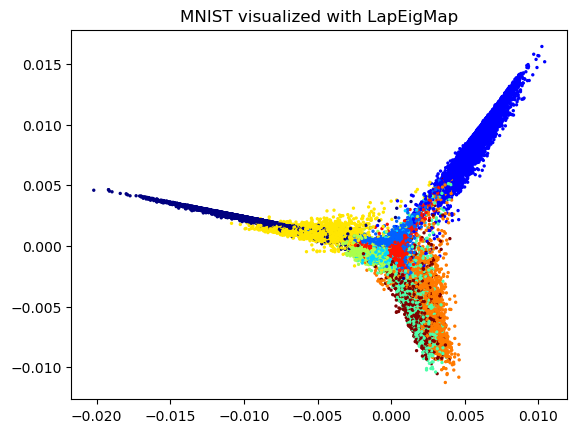

In [4]:
# Compute k-NN graph
kNN = 10
dist = 'euclidean'
W = construct_knn_graph(X, kNN, dist)
#print(W)

# Laplacian Eigenmaps
start = time.time()
Xvis,Yvis,Zvis = nldr_visualization(W)
print('time(sec):',(time.time()-start)/1)

# 2D Visualization
plt.figure(3)
plt.scatter(Xvis, Yvis, c=C, s=2, color=pyplot.jet())
plt.title('MNIST visualized with LapEigMap') 
plt.show()


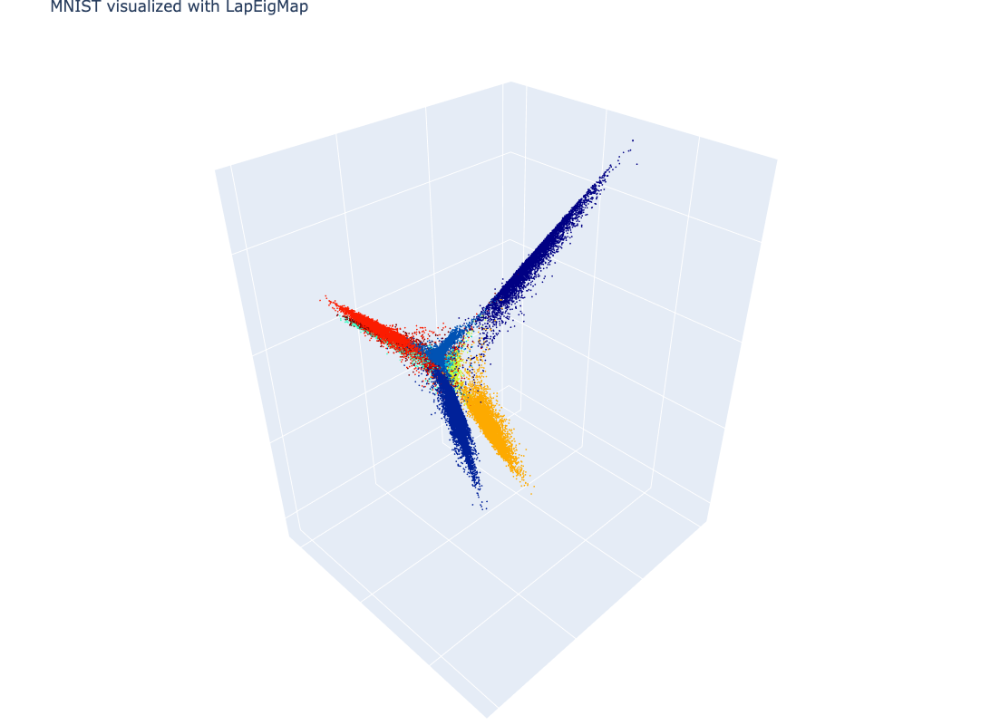

In [5]:
# 3D Visualization
import plotly.graph_objects as go
data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1)) # data as points
# data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1, showscale=True)) # w/ colobar 
fig = go.Figure(data=[data]) 
fig.update_layout(margin=dict(l=0, r=0, b=0, t=25, pad=0)) # tight layout but t=25 required for showing title 
fig.update_layout(autosize=False, width=800, height=800, title_text="MNIST visualized with LapEigMap") # figure size and title
# fig.update_layout(scene = dict(xaxis = dict(visible=False), yaxis = dict(visible=False), zaxis = dict(visible=False))) # no grid, no axis 
# fig.update_layout(scene = dict(xaxis_title = ' ', yaxis_title = ' ', zaxis_title = ' ')) # no axis name 
fig.update_layout(scene = dict(zaxis = dict(showgrid = True, showticklabels = False), zaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(yaxis = dict(showgrid = True, showticklabels = False), yaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(xaxis = dict(showgrid = True, showticklabels = False), xaxis_title = ' ') ) # no range values, no axis name, grid on
fig.show()


# TSNE for MNIST

## Question: explore TSNE
Visualize the MNIST dataset using tsne with different perplexity parameters (hint: recommanded range is 5-50)

**1. How the visualization changes with different values of perplexity?**
   
Perplexity in t-SNE is related to the number of nearest neighbors considered when modeling pairwise similarities in the original high-dimensional space. It's a smooth tuning parameter that determines how much emphasis the algorithm places on the local vs. global relationships in the data:

- Low perplexity values (e.g., 5-20) focus more on local structures, ensuring that the algorithm preserves small, tight clusters of points that are close together in the original space.
- High perplexity values (e.g., 20-50) incorporate more distant neighbors, and the visualization focuses more on broader structures in the dataset.

Beyond this range, the visualization may become "strange".

**2. Explain the effect in mathmatical ways.**

   
The conditional probability in high-dimensional space is defined as
$$P_{j|i} = \frac{\exp\left(- \frac{\| x_i - x_j \|^2}{2\sigma_i^2}\right)}{\sum_{k \neq i} \exp\left(- \frac{\| x_i - x_k \|^2}{2\sigma_i^2}\right)}$$

The $\sigma$ controls how the gaussian "spread out": a low $\sigma$ values will put more probability mass around the center, thus focusing on local features.  

Instead of defining the $\sigma$ directly, which can be sensitive to the distribution of data, we instead search for the $\sigma$ value that based on the specified perplexity which is defined as:
$$\text{Perplexity}(P_i) = 2^{H(P_i)}$$

where $H(P_i)$ is the Shannon entropy of the conditional distribution $P_i$:
$$H(P_i) = - \sum_j P_{j|i} \log_2 P_{j|i}$$

Low entropy will result into a "peaked" distribution, corresponding to low $\sigma$


(60000, 784)
[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 60000 samples in 0.058s...
[t-SNE] Computed neighbors for 60000 samples in 21.481s...
[t-SNE] Computed conditional probabilities for sample 1000 / 60000
[t-SNE] Computed conditional probabilities for sample 2000 / 60000
[t-SNE] Computed conditional probabilities for sample 3000 / 60000
[t-SNE] Computed conditional probabilities for sample 4000 / 60000
[t-SNE] Computed conditional probabilities for sample 5000 / 60000
[t-SNE] Computed conditional probabilities for sample 6000 / 60000
[t-SNE] Computed conditional probabilities for sample 7000 / 60000
[t-SNE] Computed conditional probabilities for sample 8000 / 60000
[t-SNE] Computed conditional probabilities for sample 9000 / 60000
[t-SNE] Computed conditional probabilities for sample 10000 / 60000
[t-SNE] Computed conditional probabilities for sample 11000 / 60000
[t-SNE] Computed conditional probabilities for sample 12000 / 60000
[t-SNE] Computed conditional probab

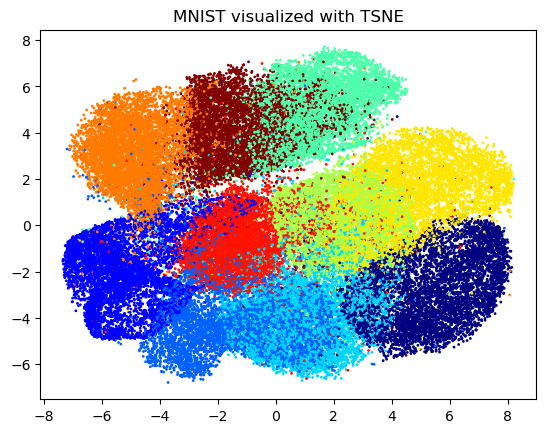

In [6]:
# TSNE
start = time.time()
#tsne = TSNE(n_components=3, learning_rate='auto', init='random', perplexity=3)
tsne = TSNE(n_components=3, verbose=1, perplexity=40, n_iter=300)
print(X.shape)
embedding = tsne.fit_transform(X)
print('time(sec):',(time.time()-start)/1)
print(embedding.shape)
Xvis = embedding[:,0]
Yvis = embedding[:,1]
Zvis = embedding[:,2]

# 2D Visualization
plt.figure(3)
plt.scatter(Xvis, Yvis, c=C, s=1, color=pyplot.jet())
plt.title('MNIST visualized with TSNE') 
plt.show()


In [8]:
# 3D Visualization
import plotly.graph_objects as go
data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1)) # data as points
# data = go.Scatter3d(x=Xvis, y=Yvis, z=Zvis, mode='markers', marker=dict(size=1, color=C, colorscale='jet', opacity=1, showscale=True)) # w/ colobar 
fig = go.Figure(data=[data]) 
fig.update_layout(margin=dict(l=0, r=0, b=0, t=25, pad=0)) # tight layout but t=25 required for showing title 
fig.update_layout(autosize=False, width=800, height=800, title_text="MNIST visualized with TSNE") # figure size and title
# fig.update_layout(scene = dict(xaxis = dict(visible=False), yaxis = dict(visible=False), zaxis = dict(visible=False))) # no grid, no axis 
# fig.update_layout(scene = dict(xaxis_title = ' ', yaxis_title = ' ', zaxis_title = ' ')) # no axis name 
fig.update_layout(scene = dict(zaxis = dict(showgrid = True, showticklabels = False), zaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(yaxis = dict(showgrid = True, showticklabels = False), yaxis_title = ' ') ) # no range values, no axis name, grid on
fig.update_layout(scene = dict(xaxis = dict(showgrid = True, showticklabels = False), xaxis_title = ' ') ) # no range values, no axis name, grid on
fig.show()
